In [11]:
import numpy as np
import torch, os

import sys
sys.path.append('C:/Users/owner/Documents/GitHub/Scalable-Hyperspectral-3D-Imaging/dataset')
sys.path.append('C:/Users/owner/Documents/GitHub/Scalable-Hyperspectral-3D-Imaging')

from utils import constants as C
from data import create_data
from utils import load_data
from image_formation import pixel_renderer

import matplotlib.pyplot as plt
import cv2

### New Rendering Method

In [12]:
img_hyp_text_dir = "C:/Users/owner/Documents/GitHub/Scalable-Hyperspectral-3D-Imaging/dataset/image_formation/img_hyp_text"
img_hyp_file = "img_hyp_text_000.npy"

depth = load_data.load_data().load_depth(0).reshape(C.CAM_RES*C.CAM_RES)
hyp = load_data.load_data().load_hyp_img(0).reshape(C.CAM_RES*C.CAM_RES, 77)
hyp = torch.tensor(hyp, dtype = torch.float32)

pixel_num = C.CAM_RES*C.CAM_RES
cam_coord = create_data.createData('coord', pixel_num, random=False).create()

render = pixel_renderer.PixelRenderer(depth=depth, hyp= hyp, cam_coord= cam_coord, pixel_num = pixel_num).patt_form()

c:\Users\owner\anaconda3\envs\hyper3d\lib\site-packages\ipykernel_launcher.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


In [13]:
# new_render_result = render[0][:,idx,:] # idx : N pattern index
# new_render_result = new_render_result.reshape(640,640,3)

# plotting을 N번째 패턴에 대한 RGB를 plotting 해야함

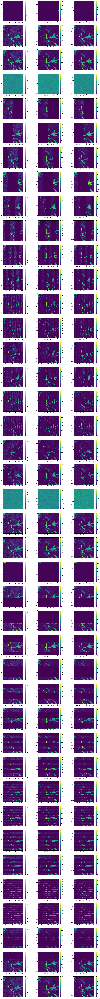

In [14]:
plt.figure(figsize=(20,200))

for i in range(41):
    new_render_result = render[0][:,i,:].detach().cpu().numpy() # idx : N pattern index
    new_render_result = new_render_result.reshape(640,640,3)
    
    plt.subplot(41, 3, 3*i+ 1),plt.imshow(new_render_result[:,:,0]), plt.colorbar()
    plt.subplot(41, 3, 3*i+ 2),plt.imshow(new_render_result[:,:,1]), plt.colorbar()
    plt.subplot(41, 3, 3*i+ 3),plt.imshow(new_render_result[:,:,2]), plt.colorbar()

### Existing Rendering Result

In [15]:
rendering_result_dir = "C:/Users/owner/Documents/GitHub/Scalable-Hyperspectral-3D-Imaging/result"

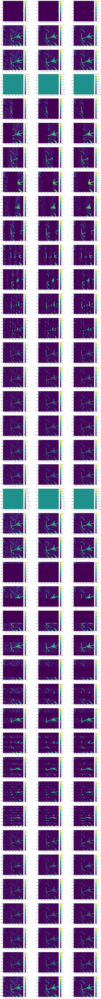

In [16]:
plt.figure(figsize=(20,200))

for i in range(41):
    image = cv2.imread(os.path.join(rendering_result_dir, 'scene_000_illum_patt_%03d.png' %(i)))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = image/255.
    image = torch.tensor(image.reshape(C.CAM_RES,C.CAM_RES, 3))
    
    plt.subplot(41, 3, 3*i+ 1),plt.imshow(image[:,:,0]), plt.colorbar()
    plt.subplot(41, 3, 3*i+ 2),plt.imshow(image[:,:,1]), plt.colorbar()
    plt.subplot(41, 3, 3*i+ 3),plt.imshow(image[:,:,2]), plt.colorbar()